<a href="https://colab.research.google.com/github/rosariomoscato/pycaret/blob/master/PyCaret_CLF102.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Binary Classification with PyCaret - Intermediate Tutorial (CLF102)
In this tutorial we will use the pycaret.classification module to learn:

- **Normalization**: How to normalize and scale the dataset
- **Transformation**: How to apply transformations that make the data linear and approximately normal
- **Ignore Low Variance**: How to remove features with statistically insignificant variances to make the experiment more efficient
- **Remove Multi-collinearity**: How to remove multi-collinearity from the dataset to boost performance of Linear algorithms
- **Group Features**: How to extract statistical information from related features in the dataset
- **Bin Numeric Variables**: How to bin numeric variables and transform numeric features into categorical ones using 'sturges' rule
- **Model Ensembling and Stacking**: How to boost model performance using several ensembling techniques such as Bagging, Boosting, Soft/hard Voting and Generalized Stacking
- **Model Calibration**: How to calibrate probabilities of a classification model
- **Experiment Logging**: How to log experiments in PyCaret using MLFlow backend


In [ ]:
!pip install pycaret

### For Google colab users

In [ ]:
from pycaret.utils import enable_colab
enable_colab()

Colab mode enabled.


## Dataset for the Tutorial

Dataset Acknowledgements:

Lichman, M. (2013). UCI Machine Learning Repository. Irvine, CA: University of California, School of Information and Computer Science.

The original dataset and data dictionary can be [found here](https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients) at the UCI Machine Learning Repository.

## Getting the Data
You can download the data from the original source [found here](https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients) and load it using the pandas read_csv function or you can use PyCaret's data respository to load the data using the get_data function.

In [ ]:
# Notice that when the profile parameter is to True, it displays a data profile for exploratory data analysis. 
from pycaret.datasets import get_data
dataset = get_data('credit', profile=True)

Summarize dataset:   0%|          | 0/37 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#check the shape of data
dataset.shape

(24000, 24)



In order to demonstrate the predict_model() function on unseen data, a sample of 1200 rows has been withheld from the original dataset to be used for predictions. This should not be confused with a train/test split as this particular split is performed to simulate a real life scenario. Another way to think about this is that these 1200 records were not available at the time when the machine learning experiment was performed.


In [ ]:
data = dataset.sample(frac=0.95, random_state=786)
data_unseen = dataset.drop(data.index)

data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions ' + str(data_unseen.shape))

Data for Modeling: (22800, 24)
Unseen Data For Predictions (1200, 24)


## Setting up Environment 
In the previous tutorial Binary Classification (CLF101) we learned how to initialize the environment in pycaret using setup(). No additional parameters were passed in our last example as we did not perform any pre-processing steps. In this example we will take it to the next level by customizing the pre-processing pipeline using setup().


In [ ]:
from pycaret.classification import *

In [ ]:
exp_clf102 = setup(data = data, target = 'default', session_id=123,
                  normalize = True, 
                  transformation = True, 
                  ignore_low_variance = True,
                  remove_multicollinearity = True, multicollinearity_threshold = 0.95,
                  bin_numeric_features = ['LIMIT_BAL', 'AGE'],
                  group_features = [['BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'],
                                   ['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']],
                  log_experiment = True, experiment_name = 'credit1')


,Description,Value
0,session_id,123
1,Target,default
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(22800, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


## Comparing All Models

In [ ]:
top3 = compare_models(n_select = 3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8255,0.0000,0.3606,0.6945,0.4744,0.3822,0.4119,0.067
lda,Linear Discriminant Analysis,0.8244,0.7741,0.3780,0.6760,0.4848,0.3890,0.4130,0.361
gbc,Gradient Boosting Classifier,0.8237,0.7769,0.3554,0.6873,0.4683,0.3753,0.4048,7.627
ada,Ada Boost Classifier,0.8225,0.7726,0.3388,0.6923,0.4546,0.3632,0.3965,2.050
lightgbm,Light Gradient Boosting Machine,0.8195,0.7710,0.3591,0.6603,0.4648,0.3676,0.3924,0.475
rf,Random Forest Classifier,0.8187,0.7574,0.3523,0.6599,0.4591,0.3621,0.3880,3.061
et,Extra Trees Classifier,0.8152,0.7509,0.3637,0.6348,0.4621,0.3604,0.3809,2.061
lr,Logistic Regression,0.7886,0.6940,0.1201,0.5859,0.1964,0.1329,0.1895,0.679
knn,K Neighbors Classifier,0.7586,0.6173,0.2058,0.3987,0.2712,0.1441,0.1555,0.490
svm,SVM - Linear Kernel,0.7497,0.0000,0.2514,0.3802,0.2495,0.1398,0.1546,0.385


Notice that we have used n_select parameter within compare_models. In last tutorial you have seen that compare_models by default returns the best performing model (single model based on default sort order). However you can use n_select parameter to return top N models. In this example compare_models has returned Top 3 models.

In [ ]:
type(top3)

list

In [ ]:
print(top3)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
       

For the purposes of comparison we will use the AUC score. Notice how drastically a few of the algorithms have improved after we performed the pre-processing in setup().

- Logistic Regression AUC improved from 0.6410 to 0.6957
- Naives Bayes AUC improved from 0.6442 to 0.6724
- K Nearest Neighbors AUC improved from 0.5939 to 0.6173


## Create a Model
Now we will learn about a few other parameters that may come in handy. In this section, we will create all models using 5 fold cross validation. Notice how the fold parameter is passed inside create_model() to achieve this.

In [ ]:
dt = create_model('dt', fold = 5)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7343,0.6204,0.4126,0.3967,0.4045,0.2336,0.2337
1,0.7337,0.6223,0.4212,0.3973,0.4089,0.2372,0.2374
2,0.7415,0.6329,0.4355,0.4136,0.4243,0.2578,0.2579
3,0.7340,0.6143,0.4011,0.3938,0.3974,0.2268,0.2268
4,0.7230,0.6019,0.3859,0.3710,0.3783,0.2002,0.2003
Mean,0.7333,0.6183,0.4113,0.3945,0.4027,0.2311,0.2312
SD,0.0059,0.0102,0.0169,0.0136,0.0150,0.0186,0.0186


In [ ]:
rf = create_model('rf', round = 2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.81,0.76,0.32,0.61,0.42,0.32,0.35
1,0.83,0.76,0.39,0.68,0.50,0.40,0.43
2,0.82,0.76,0.34,0.68,0.46,0.36,0.39
3,0.82,0.76,0.36,0.66,0.47,0.37,0.39
4,0.82,0.76,0.34,0.65,0.45,0.35,0.38
5,0.83,0.77,0.38,0.68,0.48,0.39,0.41
6,0.82,0.77,0.35,0.68,0.46,0.37,0.40
7,0.83,0.74,0.35,0.71,0.47,0.38,0.41
8,0.81,0.74,0.32,0.63,0.43,0.33,0.35
9,0.81,0.76,0.35,0.63,0.45,0.35,0.37


## Tune a Model
In pycaret.classification all hyperparameter tuning is set to optimize for Accuracy by default which can be changed using the optimize parameter. See the example below:

In [ ]:
tuned_rf = tune_model(rf, optimize = 'AUC')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7575,0.7715,0.6562,0.4617,0.5420,0.3838,0.3948
1,0.7594,0.7683,0.6619,0.4648,0.5461,0.3892,0.4004
2,0.7556,0.7687,0.6447,0.4582,0.5357,0.3763,0.3864
3,0.7400,0.7838,0.6791,0.4389,0.5332,0.3643,0.3810
4,0.7525,0.7940,0.6734,0.4554,0.5434,0.3822,0.3959
5,0.7594,0.7813,0.6619,0.4648,0.5461,0.3892,0.4004
6,0.7312,0.7657,0.6791,0.4278,0.5249,0.3507,0.3689
7,0.7494,0.7475,0.5845,0.4444,0.5050,0.3413,0.3470
8,0.7299,0.7422,0.6189,0.4202,0.5006,0.3247,0.3361
9,0.7342,0.7603,0.6236,0.4255,0.5058,0.3328,0.3441


In [ ]:
tuned_rf2 = tune_model(rf, optimize = 'Recall')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
1,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
2,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
3,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
4,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
5,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
6,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
7,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
8,0.2187,0.5,1.0,0.2187,0.3589,0.0,0.0
9,0.2182,0.5,1.0,0.2182,0.3582,0.0,0.0




Notice how the results of tuning Random Forest Classifiers differ with the optimize param. In tuned_rf we optimized AUC resulting in 0.7691 in AUC and 0.6446 in Recall. However, in tuned_rf2 when we set the optimize parameter to Recall, it actually resulted in a better model in terms of Recall. However, AUC was compromised. Observe the differences between the hyperparameters of tuned_rf and tuned_rf2 below:


In [ ]:
plot_model(tuned_rf, plot = 'parameter')

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced_subsample
criterion,gini
max_depth,4
max_features,sqrt
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.0005
min_impurity_split,None


In [ ]:
plot_model(tuned_rf2, plot = 'parameter')

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced
criterion,gini
max_depth,2
max_features,log2
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.1
min_impurity_split,None


## Ensemble a Model
Ensembling is a common machine learning technique used to improve the performance of models (mostly tree based). There are various techniques for ensembling that we will cover in this section. These include Bagging and Boosting. We will use the ensemble_model() function in PyCaret which ensembles the trained base estimators using the method defined in the method parameter.

In [ ]:
# lets create a simple decision tree model that we will use for ensembling 
dt = create_model('dt')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7168,0.5928,0.3696,0.3573,0.3634,0.1813,0.1814
1,0.7456,0.6269,0.4126,0.4174,0.4150,0.2525,0.2525
2,0.7281,0.6079,0.3926,0.3816,0.3870,0.2123,0.2124
3,0.7243,0.6037,0.3868,0.3740,0.3803,0.2031,0.2031
4,0.7218,0.6148,0.4183,0.3773,0.3967,0.2166,0.2171
5,0.7381,0.6132,0.3926,0.3994,0.3960,0.2288,0.2288
6,0.7005,0.5805,0.3696,0.3333,0.3505,0.1566,0.1569
7,0.7375,0.6078,0.3782,0.3952,0.3865,0.2196,0.2197
8,0.7356,0.6257,0.4298,0.4021,0.4155,0.2449,0.2451
9,0.7511,0.6392,0.4425,0.4314,0.4369,0.2772,0.2772


###  Bagging

In [ ]:
bagged_dt = ensemble_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8033,0.7286,0.3238,0.5916,0.4185,0.3121,0.3327
1,0.8133,0.7340,0.3696,0.6232,0.4640,0.3598,0.3778
2,0.8089,0.7291,0.3066,0.6294,0.4123,0.3141,0.3431
3,0.8026,0.7361,0.3181,0.5904,0.4134,0.3074,0.3286
4,0.8033,0.7244,0.3181,0.5936,0.4142,0.3087,0.3304
5,0.8139,0.7234,0.3496,0.6354,0.4510,0.3502,0.3728
6,0.7957,0.7251,0.2980,0.5622,0.3895,0.2805,0.3009
7,0.8089,0.7233,0.3095,0.6279,0.4146,0.3158,0.3441
8,0.8083,0.7114,0.3238,0.6175,0.4248,0.3230,0.3472
9,0.8107,0.7269,0.3477,0.6173,0.4449,0.3413,0.3618


In [ ]:
# check the parameters of bagged_dt
print(bagged_dt)

BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight=None,
                                                        criterion='gini',
                                                        max_depth=None,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                        min_weight_fraction_leaf=0.0,
                                                        presort='deprecated',
                                                        random_state=123,
 

Notice how ensembling has improved the AUC of Decision Tree Classifier. In the above example we have used the default parameters of ensemble_model() which uses the Bagging method. Let's try Boosting by changing the method parameter in ensemble_model(). See example below:


### Boosting

In [ ]:
boosted_dt = ensemble_model(dt, method = 'Boosting')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7368,0.6673,0.3467,0.3866,0.3656,0.2002,0.2006
1,0.7907,0.7058,0.3725,0.5306,0.4377,0.3140,0.3214
2,0.7682,0.6294,0.2665,0.4493,0.3345,0.2051,0.2154
3,0.7794,0.6707,0.3266,0.4935,0.3931,0.2651,0.2735
4,0.7914,0.7229,0.3582,0.5342,0.4288,0.3072,0.3164
5,0.7556,0.6836,0.4327,0.4402,0.4364,0.2804,0.2804
6,0.7638,0.6566,0.3266,0.4453,0.3769,0.2354,0.2397
7,0.7851,0.6734,0.3066,0.5144,0.3842,0.2640,0.2770
8,0.7519,0.6646,0.4499,0.4349,0.4423,0.2828,0.2828
9,0.7944,0.6949,0.3937,0.5394,0.4551,0.3322,0.3385


Notice how easy it is to ensemble models in PyCaret. By simply changing the method parameter you can do bagging or boosting which would otherwise have taken multiple lines of code. Note that ensemble_model() will by default build 10 estimators. This can be changed using the n_estimators parameter. Increasing the number of estimators can sometimes improve results. See an example below:

In [ ]:
bagged_dt2 = ensemble_model(dt, n_estimators=50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8120,0.7464,0.3467,0.6269,0.4465,0.3444,0.3663
1,0.8183,0.7596,0.3696,0.6482,0.4708,0.3709,0.3922
2,0.8177,0.7509,0.3524,0.6543,0.4581,0.3601,0.3851
3,0.8089,0.7531,0.3438,0.6122,0.4404,0.3359,0.3563
4,0.8152,0.7560,0.3438,0.6452,0.4486,0.3497,0.3748
5,0.8221,0.7577,0.3725,0.6667,0.4779,0.3809,0.4044
6,0.8014,0.7512,0.3381,0.5784,0.4268,0.3165,0.3332
7,0.8202,0.7425,0.3524,0.6685,0.4615,0.3658,0.3928
8,0.8177,0.7347,0.3524,0.6543,0.4581,0.3601,0.3851
9,0.8157,0.7557,0.3822,0.6274,0.4750,0.3711,0.3879


Notice how increasing the n_estimators parameter has improved the performance of ensembled model. The bagged_dt model with the default 10 estimators resulted in an AUC of 0.7262 whereas in bagged_dt2 where n_estimators = 50 the AUC improved to 0.7508.


### Blending
Blending is another common technique for ensembling that can be used in PyCaret. It uses predictions from multiple models to generate a final set of predictions using voting / majority consensus from all of the models passed in the estimator_list parameter. The method parameter can be used to define the type of voting. When set to hard, it uses labels for majority rule voting. When set to soft it uses the sum of predicted probabilities instead of the label. Default value of method is set to auto which means it tries to use soft method and fall back to hard if the former is not supported. Let's see an example below:


In [ ]:
# train individual models to blend
lightgbm = create_model('lightgbm', verbose = False)
dt = create_model('dt', verbose = False)
lr = create_model('lr', verbose = False)

In [ ]:
# blend individual models
blend_soft = blend_models(estimator_list = [lightgbm, dt, lr], method = 'soft')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7914,0.7305,0.3066,0.5404,0.3912,0.2767,0.2929
1,0.8014,0.7508,0.3238,0.5825,0.4162,0.3081,0.3274
2,0.7801,0.7369,0.3610,0.4961,0.4179,0.2865,0.2920
3,0.7632,0.7481,0.3696,0.4495,0.4057,0.2595,0.2615
4,0.7920,0.7600,0.3524,0.5371,0.4256,0.3052,0.3153
5,0.7957,0.7509,0.3181,0.5578,0.4051,0.2928,0.3096
6,0.7531,0.7088,0.3467,0.4216,0.3805,0.2282,0.2299
7,0.7801,0.7280,0.3410,0.4958,0.4041,0.2748,0.2821
8,0.7757,0.7347,0.3840,0.4838,0.4281,0.2909,0.2939
9,0.7906,0.7475,0.4109,0.5257,0.4613,0.3337,0.3376


In [ ]:
# blend individual models
blend_hard = blend_models(estimator_list = [lightgbm, dt, lr], method = 'hard')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8008,0.0,0.2436,0.6115,0.3484,0.2556,0.2935
1,0.8195,0.0,0.3009,0.7047,0.4217,0.3346,0.3773
2,0.8120,0.0,0.2951,0.6561,0.4071,0.3140,0.3495
3,0.8139,0.0,0.3266,0.6477,0.4343,0.3371,0.3654
4,0.8145,0.0,0.2894,0.6779,0.4056,0.3161,0.3565
5,0.8133,0.0,0.2693,0.6861,0.3868,0.3006,0.3465
6,0.8064,0.0,0.2837,0.6266,0.3905,0.2944,0.3271
7,0.8127,0.0,0.2579,0.6923,0.3758,0.2917,0.3412
8,0.8102,0.0,0.2722,0.6597,0.3854,0.2954,0.3360
9,0.8138,0.0,0.3247,0.6457,0.4321,0.3350,0.3634


In [ ]:
# blend top3 models from compare_models
blender_top3 = blend_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8183,0.0,0.3582,0.6545,0.4630,0.3647,0.3887
1,0.8308,0.0,0.3868,0.7068,0.5000,0.4085,0.4354
2,0.8239,0.0,0.3467,0.6954,0.4627,0.3712,0.4034
3,0.8296,0.0,0.3754,0.7081,0.4906,0.3997,0.4288
4,0.8214,0.0,0.3524,0.6758,0.4633,0.3686,0.3968
5,0.8315,0.0,0.3983,0.7020,0.5082,0.4157,0.4401
6,0.8227,0.0,0.3610,0.6774,0.4710,0.3762,0.4031
7,0.8283,0.0,0.3553,0.7168,0.4751,0.3861,0.4202
8,0.8202,0.0,0.3553,0.6667,0.4636,0.3674,0.3936
9,0.8245,0.0,0.3793,0.6735,0.4853,0.3893,0.4126


In [ ]:
print(blender_top3.estimators_)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
       

### Stacking
Stacking is another popular technique for ensembling but is less commonly implemented due to practical difficulties. Stacking is an ensemble learning technique that combines multiple models via a meta-model. Another way to think about stacking is that multiple models are trained to predict the outcome and a meta-model is created that uses the predictions from those models as an input along with the original features. The implementation of stack_models() is based on Wolpert, D. H. (1992b). Stacked generalization ([Read More](https://www.sciencedirect.com/science/article/abs/pii/S0893608005800231)).

Let's see an example below using the top 3 models we have obtained from compare_models:


In [ ]:
stack_soft = stack_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7863,0.7020,0.0802,0.5833,0.1411,0.0931,0.1554
1,0.7863,0.7035,0.0802,0.5833,0.1411,0.0931,0.1554
2,0.7870,0.6895,0.1461,0.5484,0.2308,0.1528,0.1984
3,0.7826,0.7147,0.0802,0.5185,0.1390,0.0854,0.1358
4,0.7957,0.7268,0.1146,0.7018,0.1970,0.1445,0.2249
5,0.7895,0.6993,0.1261,0.5867,0.2075,0.1411,0.1977
6,0.7926,0.7191,0.0917,0.6957,0.1620,0.1171,0.1988
7,0.7945,0.6803,0.1375,0.6400,0.2264,0.1616,0.2263
8,0.7876,0.6765,0.1146,0.5714,0.1909,0.1272,0.1828
9,0.7868,0.7019,0.0805,0.5833,0.1414,0.0935,0.1557


In [ ]:
gbc = create_model('gbc')
stack_soft2 = stack_models(top3, meta_model=gbc)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8208,0.7801,0.3496,0.6740,0.4604,0.3656,0.3940
1,0.8308,0.7862,0.3868,0.7068,0.5000,0.4085,0.4354
2,0.8283,0.7799,0.3381,0.7329,0.4627,0.3767,0.4167
3,0.8302,0.7844,0.3639,0.7216,0.4838,0.3951,0.4283
4,0.8221,0.7919,0.3524,0.6796,0.4642,0.3701,0.3988
5,0.8315,0.7907,0.3782,0.7174,0.4953,0.4056,0.4355
6,0.8139,0.7693,0.3381,0.6413,0.4428,0.3437,0.3691
7,0.8233,0.7640,0.3381,0.6982,0.4556,0.3650,0.3993
8,0.8202,0.7629,0.3438,0.6742,0.4554,0.3610,0.3904
9,0.8295,0.7593,0.3822,0.7000,0.4944,0.4023,0.4290


Selecting which method and models to use in stacking depends on the statistical properties of the dataset. Experimenting with different models and methods is the best way to find out which configuration will work best. However as a general rule of thumb, models with strong yet diverse performance tend to improve results when used in stacking.

Before we wrap up this section, there is another parameter in stack_models() that we haven't seen yet called **restack**. This parameter controls the ability to expose the raw data to the meta model. When set to True, it exposes the raw data to the meta model along with all the predictions of the base level models. By default it is set to True.

## Model Calibration
When performing classification you often not only want to predict the class label (outcome such as 0 or 1), but also obtain the probability of the respective outcome which provides a level of confidence on the prediction. Some models can give you poor estimates of the class probabilities and some do not even support probability prediction. Well calibrated classifiers are probabilistic and provide outputs in the form of probabilities that can be directly interpreted as a confidence level. PyCaret allows you to calibrate the probabilities of a given model through the calibrate_model() function. See an example below:


In [ ]:
rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8076,0.7648,0.3238,0.6141,0.4240,0.3216,0.3454
1,0.8271,0.7553,0.3926,0.6816,0.4982,0.4027,0.4251
2,0.8208,0.7606,0.3438,0.6780,0.4563,0.3624,0.3924
3,0.8195,0.7563,0.3639,0.6580,0.4686,0.3706,0.3942
4,0.8158,0.7565,0.3438,0.6486,0.4494,0.3511,0.3767
5,0.8252,0.7655,0.3754,0.6823,0.4843,0.3895,0.4148
6,0.8214,0.7651,0.3524,0.6758,0.4633,0.3686,0.3968
7,0.8258,0.7423,0.3496,0.7052,0.4674,0.3772,0.4104
8,0.8102,0.7428,0.3238,0.6278,0.4272,0.3271,0.3529
9,0.8132,0.7644,0.3534,0.6276,0.4522,0.3500,0.3710


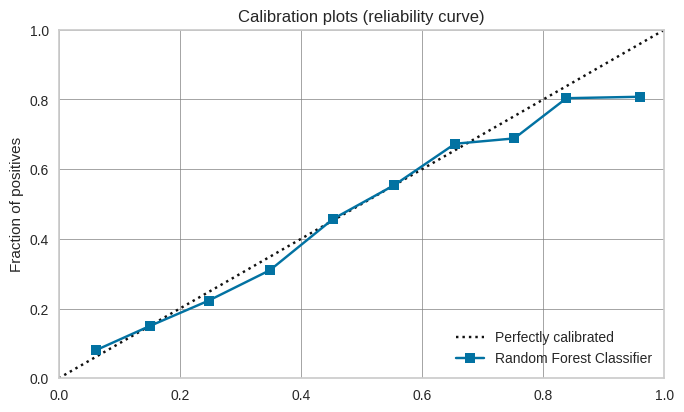

In [ ]:
plot_model(rf, plot='calibration')

In [ ]:
calibrated_rf = calibrate_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8108,0.7664,0.3123,0.6374,0.4192,0.3217,0.3509
1,0.8289,0.7625,0.3754,0.7043,0.4897,0.3982,0.4267
2,0.8183,0.7704,0.3009,0.6954,0.4200,0.3317,0.3728
3,0.8252,0.7668,0.3639,0.6902,0.4765,0.3835,0.4118
4,0.8208,0.7693,0.3381,0.6821,0.4521,0.3592,0.3909
5,0.8258,0.7779,0.3610,0.6961,0.4755,0.3834,0.4131
6,0.8227,0.7696,0.3438,0.6897,0.4589,0.3668,0.3986
7,0.8283,0.7520,0.3352,0.7358,0.4606,0.3751,0.4162
8,0.8127,0.7527,0.3209,0.6437,0.4283,0.3309,0.3597
9,0.8163,0.7616,0.3362,0.6536,0.4440,0.3473,0.3749


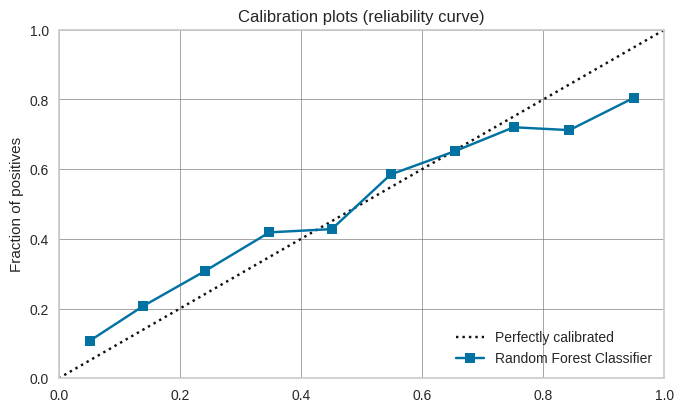

In [ ]:
plot_model(calibrated_rf, plot='calibration')

Notice how different the above 2 plots look. One is before calibration and one is after. A perfectly calibrated classifier will follow the black dotted line in the above plots. Not only is calibrated_rf better calibrated but the AUC has also improved from 0.7574 to 0.7649. By default, calibrate_model() uses the **sigmoid method** which corresponds to **Platt's approach**. The other available method is **isotonic** which is a non-parametric approach. See an example of calibration using the isotonic method below:


In [ ]:
calibrated_rf_isotonic = calibrate_model(rf, method = 'isotonic')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8102,0.7635,0.3181,0.6307,0.4229,0.3237,0.3509
1,0.8308,0.7644,0.3926,0.7026,0.5037,0.4114,0.4368
2,0.8239,0.7696,0.3324,0.7073,0.4522,0.3632,0.4001
3,0.8264,0.7662,0.3840,0.6837,0.4917,0.3969,0.4209
4,0.8195,0.7692,0.3438,0.6704,0.4545,0.3596,0.3884
5,0.8277,0.7778,0.3696,0.7011,0.4841,0.3923,0.4213
6,0.8195,0.7687,0.3467,0.6685,0.4566,0.3612,0.3892
7,0.8271,0.7511,0.3524,0.7110,0.4713,0.3816,0.4153
8,0.8120,0.7507,0.3410,0.6296,0.4424,0.3412,0.3644
9,0.8125,0.7617,0.3506,0.6256,0.4494,0.3470,0.3682


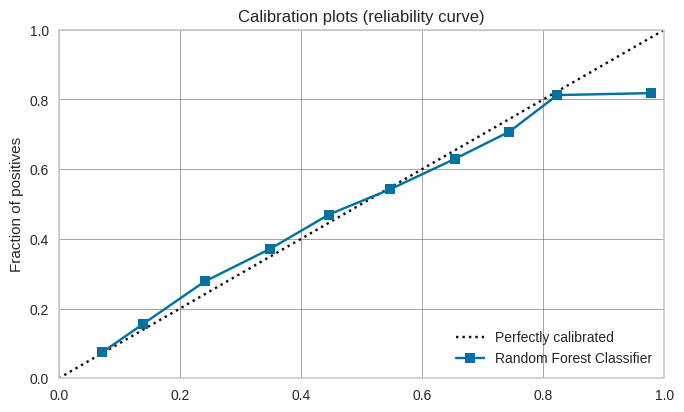

In [ ]:
plot_model(calibrated_rf_isotonic, plot='calibration')

## Experiment Logging
PyCaret >= 2.0 embeds MLflow Tracking component as a backend API and UI for logging parameters, code versions, metrics, and output files when running your machine learning code and for later visualizing the results. To log your experiments in pycaret simply use log_experiment and experiment_name parameter in the setup function, as we did in this example.

You can start the UI on https://localhost:5000. Simply initiate the MLFlow server from command line or from notebook. See example below:


In [ ]:
# to start the MLFlow server from notebook:
!mlflow ui

[2021-03-06 15:57:59 +0000] [12466] [INFO] Starting gunicorn 20.0.4
[2021-03-06 15:57:59 +0000] [12466] [INFO] Listening at: http://127.0.0.1:5000 (12466)
[2021-03-06 15:57:59 +0000] [12466] [INFO] Using worker: sync
[2021-03-06 15:57:59 +0000] [12469] [INFO] Booting worker with pid: 12469
[2021-03-06 15:58:01 +0000] [12466] [INFO] Handling signal: int

Aborted!
[2021-03-06 15:58:01 +0000] [12469] [INFO] Worker exiting (pid: 12469)
[2021-03-06 15:58:01 +0000] [12466] [INFO] Shutting down: Master
